In [3]:
!pip install Yolo

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.2/56.2 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 122.5/122.5 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.0/13.0 MB 33.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 39.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.2/139.2 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.8/117.8 kB 8.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 548.2/548.2 kB 27.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 722.2/722.2 kB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.2/83.2 kB 5.8 MB/s eta 0:00:00
  Attempting uninstall: keyring
    Found existing installation: keyring 23.5.0
    Uninstalling keyring-23.5.0:
      Successfully uninstalled keyring-23.5.0
  Attempting uninstall: rsa
    Found existing installation: rsa 4.9
    Uninstalling rsa-4.9:
      Successfully uninstalled r

In [2]:
!pip install torch torchvision onnx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 52.8 MB/s eta 0:00:00


In [1]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [11]:
# ESTO YA NO SIRVE, NO ES NECESARIO, pero es bueno tener el enlace a la mano
#!gdown --folder https://drive.google.com/drive/folders/1Ge5m5oMqyAvGhObLVoZh87L2HYnNJcqj?usp=sharing -O dataset

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1UGgFsJptTs6wQZfibmmW0KaHijyVOlsM
To: /content/datasets/armas_de_fuego.zip
100% 12.0M/12.0M [00:00<00:00, 87.8MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1xVqwcY0Xpj4SfBE-_ubsNE4FtDAPi_At
To: /content/datasets/dinamita.zip
100% 5.88M/5.88M [00:00<00:00, 36.2MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloa

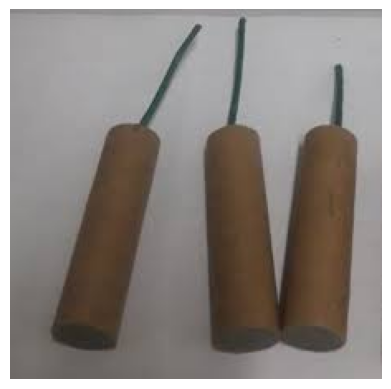

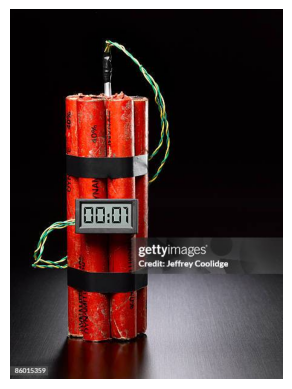

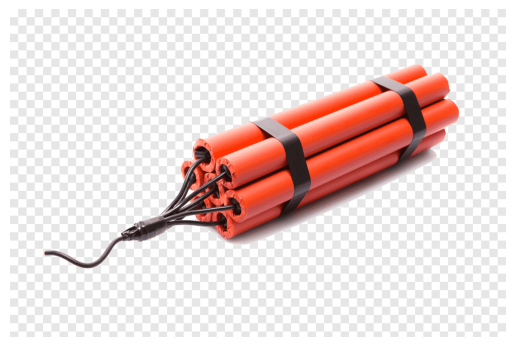

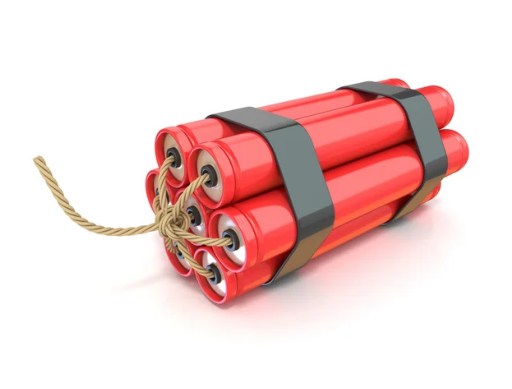

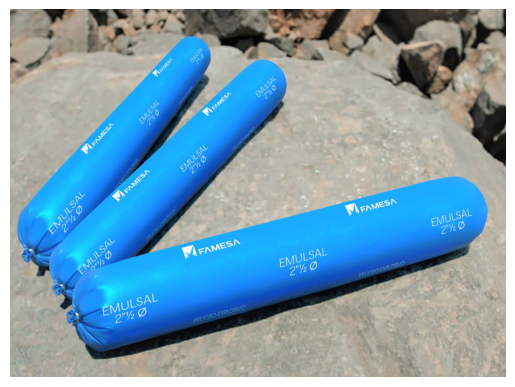

...

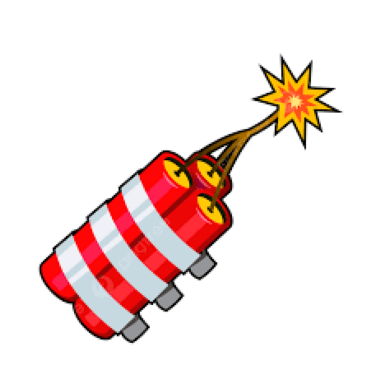

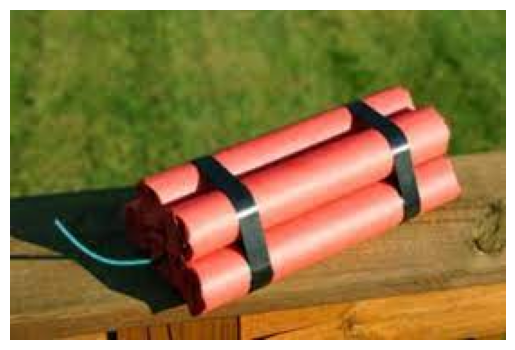

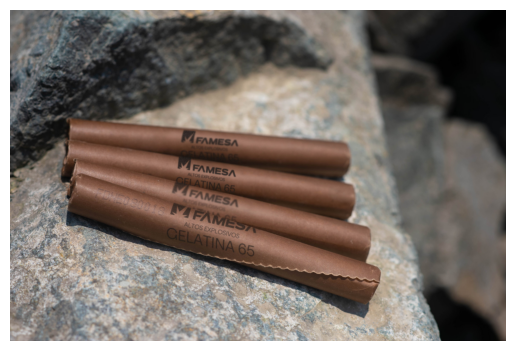

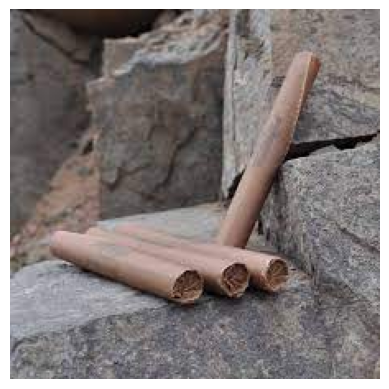

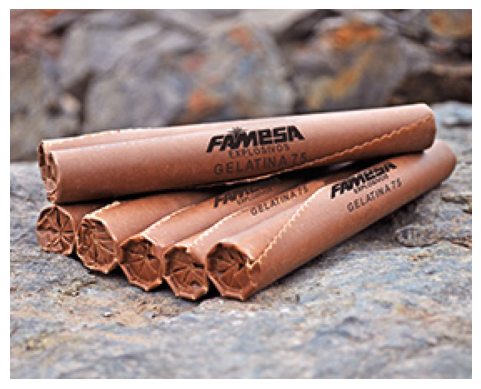

In [4]:
# CARGAR LAS IMAGENES

import os
import zipfile
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Crear carpeta para almacenar los datos
os.makedirs('datasets', exist_ok=True)

# Enlaces de los archivos .zip (REEMPLAZAR ENLACE POR LA URL DONDE ESTAN SUS IMAGENES)
urls = {
    "armas_de_fuego": "https://drive.google.com/file/d/1UGgFsJptTs6wQZfibmmW0KaHijyVOlsM/view?usp=sharing",
    "dinamita": "https://drive.google.com/file/d/1xVqwcY0Xpj4SfBE-_ubsNE4FtDAPi_At/view?usp=sharing",
    "granadas_varios_modelos": "https://drive.google.com/file/d/1RrfJbuAYBCec-1RaAIhvv7FI33HQFuJ1/view?usp=sharing",
    "armas_blancas": "https://drive.google.com/file/d/165360Amjl2gs_4RWubaaZNAZvBvivilz/view?usp=sharing"
}

# Descargar y descomprimir cada archivo .zip
for category, url in urls.items():
    output = f"datasets/{category}.zip"

    # Extraer el ID del archivo de la URL
    file_id = url.split('/')[-2]

    # Descargar el archivo usando el ID
    !gdown --id {file_id} -O {output}

    # Descomprimir el archivo .zip
    with zipfile.ZipFile(output, 'r') as zip_ref:
        zip_ref.extractall(f"datasets/{category}")

# Función para mostrar todas las imágenes en una carpeta
def show_images_from_folder(folder_path):
    # Recorrer todas las imágenes en la carpeta
    for filename in os.listdir(folder_path):
        img_path = os.path.join(folder_path, filename)

        # Verificar si el archivo es una imagen (puedes añadir más extensiones si lo necesitas)
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            img = mpimg.imread(img_path)  # Leer la imagen
            plt.imshow(img)
            plt.axis('off')  # Ocultar los ejes
            plt.show()


# Recorrer cada categoría y mostrar las imágenes
for category in os.listdir('datasets'):
    category_path = os.path.join('datasets', category)
    if os.path.isdir(category_path):  # Solo mostrar imágenes si es una carpeta
        show_images_from_folder(category_path)


/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=19sfZ4IXJ5uhhXlJmIhXuYFp6QkF3JZa9
To: /content/datasets/armas_de_fuego.zip
100% 12.5k/12.5k [00:00<00:00, 22.4MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1u1o0UZw237Ro9xT0KSckznvU4tQl-wx-
To: /content/datasets/dinamita.zip
100% 19.1k/19.1k [00:00<00:00, 49.2MB/s]
/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloa

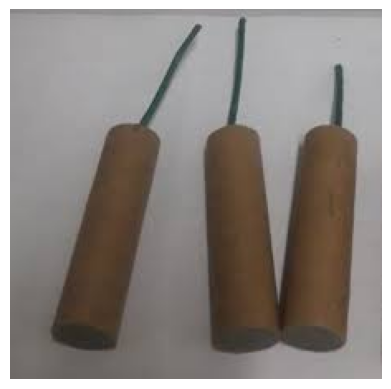

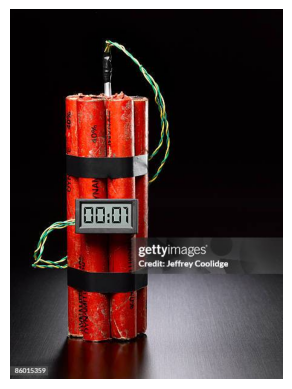

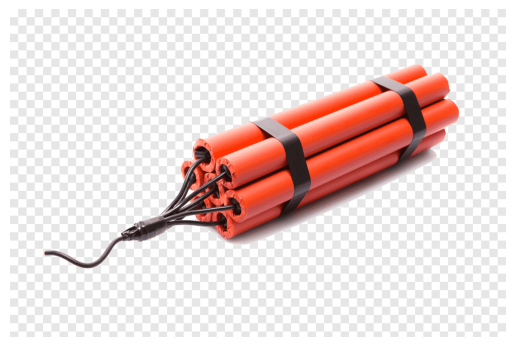

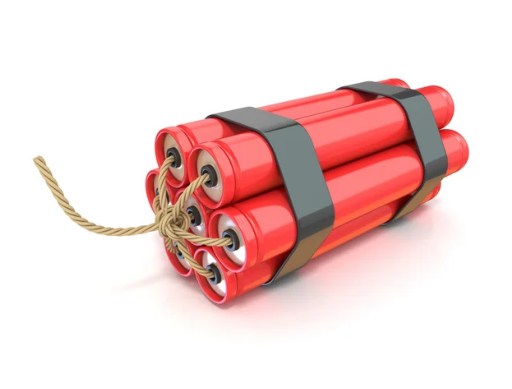

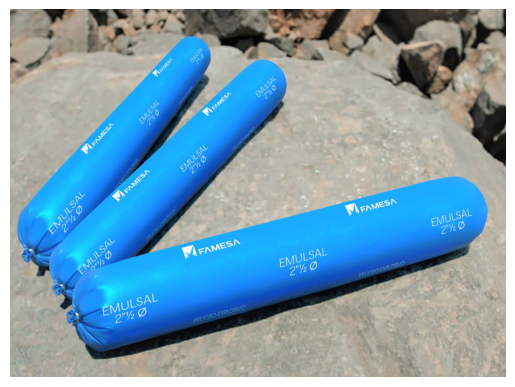

...

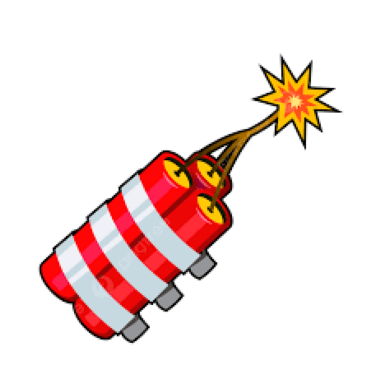

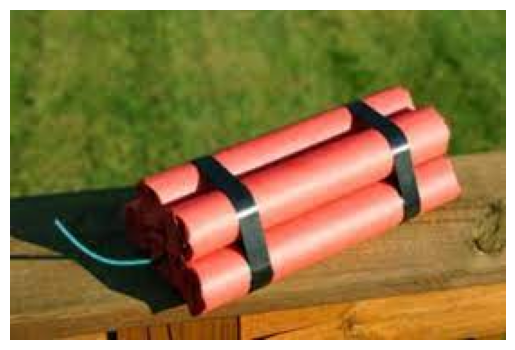

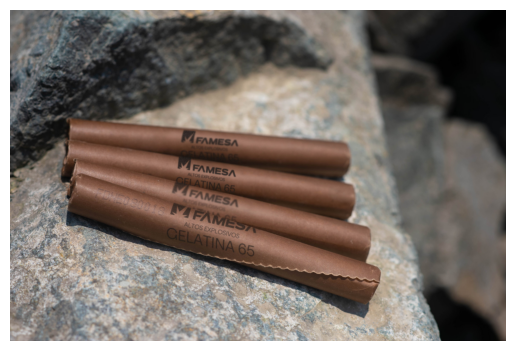

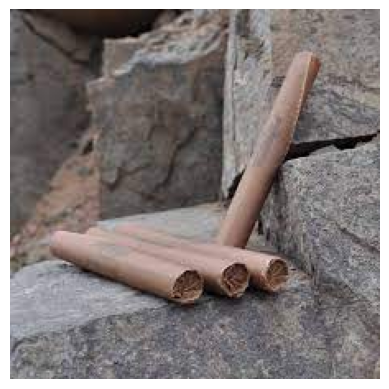

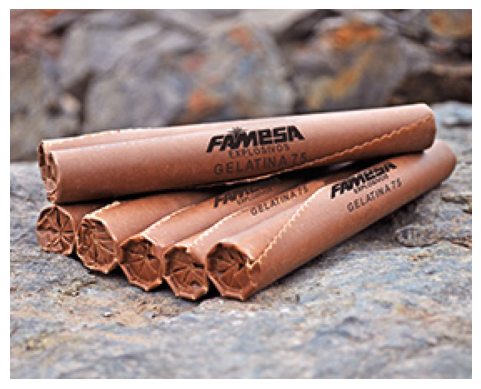

In [5]:
# CARGAR LAS LAS ETIQUETAS

import os
import zipfile
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Crear carpeta para almacenar los datos
os.makedirs('datasets', exist_ok=True)

# Enlaces de los archivos .zip (REEMPLAZAR ENLACE POR LA URL DONDE ESTAN SUS IMAGENES)
urls = {
    "armas_de_fuego": "https://drive.google.com/file/d/19sfZ4IXJ5uhhXlJmIhXuYFp6QkF3JZa9/view?usp=drive_link",
    "dinamita": "https://drive.google.com/file/d/1u1o0UZw237Ro9xT0KSckznvU4tQl-wx-/view?usp=drive_link",
    "granadas_varios_modelos": "https://drive.google.com/file/d/1M7M89A-BMqAzKH8kC8Dc1e7jT-3ectBj/view?usp=drive_link",
    "armas_blancas": "https://drive.google.com/file/d/1yEWjlKHDKWXJxKbtZ1_RTMgsXcGhX9Iw/view?usp=drive_link"
}

# Descargar y descomprimir cada archivo .zip
for category, url in urls.items():
    output = f"datasets/{category}.zip"

    # Extraer el ID del archivo de la URL
    file_id = url.split('/')[-2]

    # Descargar el archivo usando el ID
    !gdown --id {file_id} -O {output}

    # Descomprimir el archivo .zip
    with zipfile.ZipFile(output, 'r') as zip_ref:
        zip_ref.extractall(f"datasets/{category}")

# Función para mostrar todas las imágenes en una carpeta
def show_images_from_folder(folder_path):
    # Recorrer todas las imágenes en la carpeta
    for filename in os.listdir(folder_path):
        img_path = os.path.join(folder_path, filename)

        # Verificar si el archivo es una imagen (puedes añadir más extensiones si lo necesitas)
        if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.gif')):
            img = mpimg.imread(img_path)  # Leer la imagen
            plt.imshow(img)
            plt.axis('off')  # Ocultar los ejes
            plt.show()


# Recorrer cada categoría y mostrar las imágenes
for category in os.listdir('datasets'):
    category_path = os.path.join('datasets', category)
    if os.path.isdir(category_path):  # Solo mostrar imágenes si es una carpeta
        show_images_from_folder(category_path)

In [6]:
!ls datasets

armas_blancas	   armas_de_fuego      dinamita      granadas_varios_modelos
armas_blancas.zip  armas_de_fuego.zip  dinamita.zip  granadas_varios_modelos.zip


In [7]:
# CODIGO UNIFICADO QUE CARGA EL DATASET, LO CONFIGURA Y ENTRENA:
import torch
import torch.nn as nn
import torchvision.models as models
from torchvision.datasets import ImageFolder
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
import torch.optim as optim
import numpy as np

# CONFIGURAR DISPOSITIVO
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# TRANSFORMACIONES Y AUMENTACIONES
train_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.ToTensor(),
])

val_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

# CARGAR DATASET Y DIVIDIR EN ENTRENAMIENTO Y VALIDACIÓN
dataset_path = "datasets"
dataset = ImageFolder(root=dataset_path, transform=None)

# Crear datasets con transformaciones adecuadas
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

train_dataset.dataset.transform = train_transform
val_dataset.dataset.transform = val_transform

train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# DEFINIR EL MODELO
model = models.resnet18(pretrained=True)
num_classes = len(dataset.classes)
model.fc = nn.Linear(model.fc.in_features, num_classes)
model = model.to(device)

# CONFIGURAR FUNCIÓN DE PÉRDIDA Y OPTIMIZADOR
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)

# EARLY STOPPING
early_stop_patience = 5
best_val_loss = np.inf
patience_counter = 0

# ENTRENAR MODELO CON EARLY STOPPING
num_epochs = 30
for epoch in range(num_epochs):
    # Modo de entrenamiento
    model.train()
    train_loss = 0.0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)

        # Paso hacia adelante
        outputs = model(images)
        loss = criterion(outputs, labels)

        # Paso hacia atrás y optimización
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        train_loss += loss.item()

    train_loss /= len(train_loader)

    # Modo de validación
    model.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in val_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    val_loss /= len(val_loader)
    val_accuracy = 100 * correct / total

    print(f"Época {epoch+1}/{num_epochs}, Pérdida de entrenamiento: {train_loss:.4f}, Pérdida de validación: {val_loss:.4f}, Precisión en validación: {val_accuracy:.2f}%")

    # Verificar early stopping
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        patience_counter = 0
        torch.save(model.state_dict(), "best_model.pth")  # Guardar el mejor modelo
    else:
        patience_counter += 1
        if patience_counter >= early_stop_patience:
            print("Early stopping activado.")
            break

# CARGAR MEJOR MODELO Y EVALUAR
model.load_state_dict(torch.load("best_model.pth"))
model.eval()
final_correct = 0
final_total = 0

with torch.no_grad():
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)
        final_total += labels.size(0)
        final_correct += (predicted == labels).sum().item()

print(f"Precisión final en validación (mejor modelo): {100 * final_correct / final_total:.2f}%")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 89.9MB/s]


Época 1/30, Pérdida de entrenamiento: 0.8861, Pérdida de validación: 0.4903, Precisión en validación: 81.48%
Época 2/30, Pérdida de entrenamiento: 0.1521, Pérdida de validación: 0.3021, Precisión en validación: 92.59%
Época 3/30, Pérdida de entrenamiento: 0.0545, Pérdida de validación: 0.2360, Precisión en validación: 93.83%
Época 4/30, Pérdida de entrenamiento: 0.0195, Pérdida de validación: 0.2102, Precisión en validación: 92.59%
Época 5/30, Pérdida de entrenamiento: 0.0158, Pérdida de validación: 0.1959, Precisión en validación: 92.59%
Época 6/30, Pérdida de entrenamiento: 0.0124, Pérdida de validación: 0.1947, Precisión en validación: 92.59%
Época 7/30, Pérdida de entrenamiento: 0.0070, Pérdida de validación: 0.2095, Precisión en validación: 92.59%
Época 8/30, Pérdida de entrenamiento: 0.0055, Pérdida de validación: 0.2318, Precisión en validación: 92.59%
Época 9/30, Pérdida de entrenamiento: 0.0043, Pérdida de validación: 0.2198, Precisión en validación: 92.59%
Época 10/30, Pérdid

<ipython-input-7-a2f7e8f15754>:112: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load("best_model.pth"))


Precisión final en validación (mejor modelo): 92.59%


In [8]:
!pip install onnx

In [10]:
# Cargado y guardado del mejor modelo

import torch
import torchvision.models as models
import torch.nn as nn

# Asegúrate de que la arquitectura del modelo coincida
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.resnet18(pretrained=False)  # pretrained=False ya que cargarás pesos específicos
num_classes = 4  # Número de clases en tu dataset
model.fc = nn.Linear(model.fc.in_features, num_classes)
model = model.to(device)

# Cargar el modelo entrenado
model.load_state_dict(torch.load("best_model.pth"))

# Guardar como .pt
torch.save(model.state_dict(), "model.pt")

# Exportar a ONNX
dummy_input = torch.randn(1, 3, 128, 128).to(device)  # Tamaño de entrada
torch.onnx.export(model, dummy_input, "model.onnx", input_names=["input"], output_names=["output"])

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
<ipython-input-10-2ac28393b411>:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recomme

In [ ]:
!git init
!git config --global user.name "Gino LS"
!git config --global user.email "slip.ginos@gmail.com"



hint: Using 'master' as the name for the initial branch. This default branch name
hint: is subject to change. To configure the initial branch name to use in all
hint: of your new repositories, which will suppress this warning, call:
hint: 
hint: 	git config --global init.defaultBranch <name>
hint: 
hint: Names commonly chosen instead of 'master' are 'main', 'trunk' and
hint: 'development'. The just-created branch can be renamed via this command:
hint: 
hint: 	git branch -m <name>
Initialized empty Git repository in /content/.git/


In [13]:
!git init  # Inicializa un nuevo repositorio
!git config --global user.name "Roy-uwiener"
!git config --global user.email "a2021200648@uwiener.edu.pe"

hint: Using 'master' as the name for the initial branch. This default branch name
hint: is subject to change. To configure the initial branch name to use in all
hint: of your new repositories, which will suppress this warning, call:
hint: 
hint: 	git config --global init.defaultBranch <name>
hint: 
hint: Names commonly chosen instead of 'master' are 'main', 'trunk' and
hint: 'development'. The just-created branch can be renamed via this command:
hint: 
hint: 	git branch -m <name>
Initialized empty Git repository in /content/.git/


In [14]:
!git remote add origin https://github.com/Roy-uwiener/ReconocimientoArmas

In [17]:
!echo ".config/" >> .gitignore
!echo "drive/" >> .gitignore
!echo "sample_data/" >> .gitignore
!echo "__pycache__/" >> .gitignore
!echo "*.gdoc" >> .gitignore

In [18]:
!git add .gitignore
!git commit -m "Añadido .gitignore para excluir archivos innecesarios"

[master (root-commit) ed8130b] Añadido .gitignore para excluir archivos innecesarios
 1 file changed, 5 insertions(+)
 create mode 100644 .gitignore


In [20]:
!git add datasets/ best_model.pth model.pt model.onnx ReconocimientoArmas.ipynb

fatal: pathspec 'ReconocimientoArmas.ipynb' did not match any files


In [21]:
!ls

best_model.pth	datasets  drive  model.onnx  model.pt  sample_data


In [22]:
!git add notebooks/ReconocimientoArmas.ipynb

fatal: pathspec 'notebooks/ReconocimientoArmas.ipynb' did not match any files


In [ ]:
# Listar todas las ramas
!git branch -a

# Cambiar a la rama principal
!git checkout main




* main
M	.gitignore
Already on 'main'


In [ ]:
# Realiza un commit con un mensaje
!git commit -m "Añadir modelos y datasets"

On branch main
Changes not staged for commit:
  (use "git add <file>..." to update what will be committed)
  (use "git restore <file>..." to discard changes in working directory)
	modified:   .gitignore

no changes added to commit (use "git add" and/or "git commit -a")


In [ ]:
# ESTABLECER DIRECTORIO DE GITHUB
!git remote -v


origin	https://github.com/Roy-uwiener/TrabajoArmas.git (fetch)
origin	https://github.com/Roy-uwiener/TrabajoArmas.git (push)


In [ ]:
# SUBE LOS CAMBIOS A GITHUB
# AQUI TERMINA
!git push -u origin main

Enumerating objects: 453, done.
Counting objects: 100% (453/453), done.
Delta compression using up to 2 threads
Compressing objects: 100% (146/146), done.
Writing objects: 100% (453/453), 155.35 MiB | 7.99 MiB/s, done.
Total 453 (delta 5), reused 0 (delta 0), pack-reused 0
remote: Resolving deltas: 100% (5/5), done.
To https://github.com/Roy-uwiener/TrabajoArmas.git
 * [new branch]      main -> main
Branch 'main' set up to track remote branch 'main' from 'origin'.


LO SIGUIENTE SON PASOS EN CASO DE QUE EL PUSH A GITHUB FALLE:

In [ ]:
# VERIFICAR QUE TU NOMBRE Y CORREO DE GITHUB SEAN LOS CORRECTOS

!git config --global user.name
!git config --global user.email

Roy-uwiener
a2021200648@uwiener.edu.pe


In [ ]:
# SI EL PUSH DA ERROR fatal: could not read Username for 'https://github.com': No such device or address
# SE TRATA DE UN PROBLEMA DE ACCESO. SE PUEDE GENERAR UN TOKEN DE GITHUB, COPIARLO Y USARLO DE LA SGTE MANERA:


# ESTABLECER DIRECTORIO DE GITHUB CON TOKEN
!git remote set-url origin https://<TOKEN_DE_GITHUB>@github.com/usuariogithub/repositorio.git

# LUEGO VOLVER A HACER EL PUSH